<a href="https://colab.research.google.com/github/Ashwinks1995/hello/blob/master/World_Food_Facts.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# World Food Facts

### Setup Tasks 

#### Install Latest Plotly

In [0]:
import plotly
plotly.__version__

'3.6.1'

In [0]:
!pip uninstall -q -y plotly
!pip install plotly==3.6.0

    100% |████████████████████████████████| 31.1MB 1.5MB/s 
  Stored in directory: /root/.cache/pip/wheels/67/0b/29/08c7f5caed2d1ac446db982ff607b326d49bfa0bd3a67ef8c7
Successfully built plotly


In [0]:
import plotly
plotly.__version__

'3.6.1'

In [0]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=False)

## Ingest

In [0]:
import pandas as pd

In [0]:
df = pd.read_csv(
    "https://raw.githubusercontent.com/noahgift/food/master/data/features.en.openfoodfacts.org.products.csv")
df.drop(["Unnamed: 0", "exceeded", "g_sum", "energy_100g"], axis=1, inplace=True) #drop two rows we don't need
df = df.drop(df.index[[1,11877]]) #drop outlier
df.rename(index=str, columns={"reconstructed_energy": "energy_100g"}, inplace=True)
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
0,28.57,64.29,14.29,3.57,0.00000,2267.85,Banana Chips Sweetened (Whole)
2,57.14,17.86,3.57,17.86,1.22428,2835.70,Organic Salted Nut Mix
3,18.75,57.81,15.62,14.06,0.13970,1953.04,Organic Muesli
4,36.67,36.67,3.33,16.67,1.60782,2336.91,Zen Party Mix
5,18.18,60.00,21.82,14.55,0.02286,1976.37,Cinnamon Nut Granola


## EDA

In [0]:
df.columns

Index(['fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g',
       'salt_100g', 'energy_100g', 'product'],
      dtype='object')

Rows and Attributes

In [0]:
df.shape

(45026, 7)

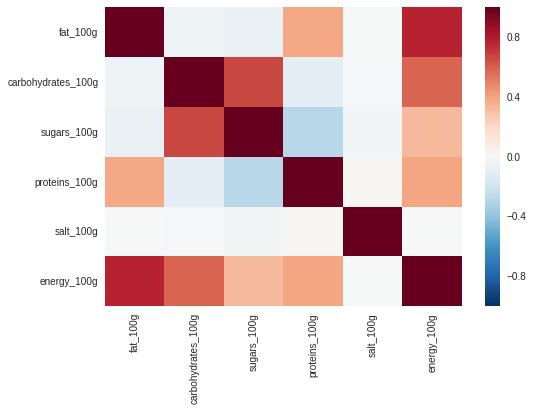

In [0]:
corr1 = df.corr()

sns.heatmap(corr1)

In [0]:
X = df.drop(['product'] ,axis =1)

In [0]:
from sklearn.decomposition import PCA

pca = PCA(n_components=4)
a = pca.fit_transform(X)
#PCA(copy=True, iterated_power='auto', n_components=1, random_state=None,
#  svd_solver='arpack', tol=0.0, whiten=False)
print(pca.explained_variance_ratio_)  
print(pca.singular_values_)  
print(pca.components_)

[9.97931541e-01 1.42344608e-03 3.12499522e-04 2.59249530e-04]
[168037.20859093   6346.37300752   2973.58092563   2708.40790752]
[[ 1.44761822e-02  2.16827230e-02  8.90215038e-03  3.90796550e-03
  -1.06516015e-04  9.99612809e-01]
 [ 2.83306222e-01 -7.67685436e-01 -5.62061094e-01  1.18753009e-01
   9.46512347e-03  1.70914137e-02]
 [-2.65051042e-01  5.06136568e-01 -8.00899131e-01  1.01898739e-01
   1.47481512e-01 -3.90426092e-04]
 [ 3.50893238e-02 -6.86562405e-02  1.25613516e-01 -1.18419674e-02
   9.89007620e-01  1.40929919e-05]]


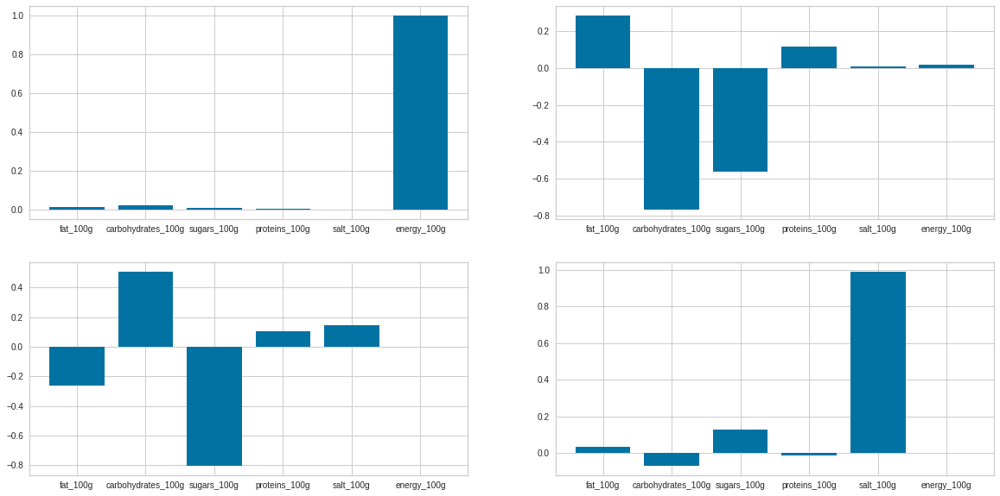

<Figure size 576x396 with 0 Axes>

In [0]:
fig = plt.figure(figsize = (20,10))

plt.subplot(2, 2, 1)
plot.line(X.columns,pca.components_[0])

plt.subplot(2, 2, 2)
plt.bar(X.columns,pca.components_[1])

plt.subplot(2, 2, 3)
plt.bar(X.columns,pca.components_[2])

plt.subplot(2, 2, 4)
plt.bar(df.drop(['product'], axis = 1).columns,pca.components_[3])

plt.show()
plt.tight_layout()

In [0]:
df_pca = pd.DataFrame(a, columns = ['Instant Energy', 'Keto diet', 'high-carb, low-sugar foods','Blood pressure causers'])

In [0]:
df_pca.shape

(45026, 4)

In [0]:
df_pca.head()

,Instant Energy,Keto diet,"high-carb, low-sugar foods",Blood pressure causers
0,1157.002307,2.187805,10.979330,-3.067733
1,1723.999580,63.364721,-10.092472,0.825505
2,842.084358,-0.500709,10.449601,-2.790846
3,1225.507404,34.597462,5.175813,-0.827959
4,865.501680,-5.372377,6.767135,-2.303430


In [0]:
midterm = pd.concat([df[['product']].reset_index(), df_pca.reset_index()], axis = 1 ).drop(['index'], axis = 1)

In [0]:
df_pca.columns.values

array(['Instant Energy', 'Keto diet', 'high-carb, low-sugar foods',
       'Blood pressure causers'], dtype=object)

In [0]:
midterm = df_pca

In [0]:
midterm.head(5)

,product,Instant Energy,Keto diet,"high-carb, low-sugar foods",Blood pressure causers
0,Banana Chips Sweetened (Whole),1157.002307,2.187805,10.979330,-3.067733
1,Organic Salted Nut Mix,1723.999580,63.364721,-10.092472,0.825505
2,Organic Muesli,842.084358,-0.500709,10.449601,-2.790846
3,Zen Party Mix,1225.507404,34.597462,5.175813,-0.827959
4,Cinnamon Nut Granola,865.501680,-5.372377,6.767135,-2.303430


First 10 Columns

## Sorting

### Sort by One Column:  Protein

In [0]:
df.sort_values(by=["proteins_100g"], ascending=False).head(10)

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
2377,0.00,0.00,0.00,100.00,0.00000,1700.00,Unflavored Gelatin
37027,0.00,0.00,0.00,100.00,0.36322,1700.00,Unflavored Gelatin
16674,6.82,22.73,13.64,86.36,14.77772,2120.51,"Fisherman's Wharf, Cocktail Shrimp"
37415,3.33,6.67,3.33,83.33,0.67818,1659.87,"Whey & Soy Protein, Flavored Drink Mix, Vanilla"
133,4.60,8.80,6.00,78.05,1.21158,1655.85,Whey Protein aus Molke 500 Gramm Vanilla
131,4.60,8.80,6.00,78.05,1.21158,1655.85,Whey Protein aus Molke 1000 Gramm Vanilla
129,4.60,8.80,6.00,78.05,1.21158,1655.85,Whey Protein aus Molke Vanilla
33115,1.67,13.33,0.00,76.67,0.00000,1595.13,Vital Wheat
37392,6.25,8.33,4.17,75.00,0.63500,1660.36,"Whey Protein Powder, Chocolate"
16669,5.36,21.43,14.29,67.86,12.79144,1726.97,"Fisherman's Wharf, Cocktail Shrimp"


### Sort by Two Columns:  Sugar, Salt

In [0]:
df.sort_values(by=["sugars_100g", "salt_100g"], ascending=[False, False]).head(10)

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
33151,0.0,0.0,100.0,0.0,71.1200,0.0,"Turkey Brine Kit, Garlic & Herb"
24783,0.0,100.0,100.0,0.0,24.1300,1700.0,Seasoning
4073,0.0,100.0,100.0,0.0,7.6200,1700.0,"Seasoning Rub, Sweet & Spicy Seafood"
10282,0.0,100.0,100.0,0.0,2.5400,1700.0,Instant Pectin
17880,0.0,100.0,100.0,0.0,0.6350,1700.0,Cranberry Cosmos Cocktail Rimming Sugar
8822,0.0,100.0,100.0,0.0,0.5588,1700.0,"Alaga, The Original Cane Flavor Syrup, Cane"
8823,0.0,100.0,100.0,0.0,0.5588,1700.0,The Original Cane Syrup
41157,0.0,100.0,100.0,0.0,0.3175,1700.0,Panela Brown Sugar Cane
41158,0.0,100.0,100.0,0.0,0.3175,1700.0,Panela Brown Sugar Cane
41159,0.0,100.0,100.0,0.0,0.3175,1700.0,Panela


## Visualizations

### Histogram

Generate distributions based on energy type

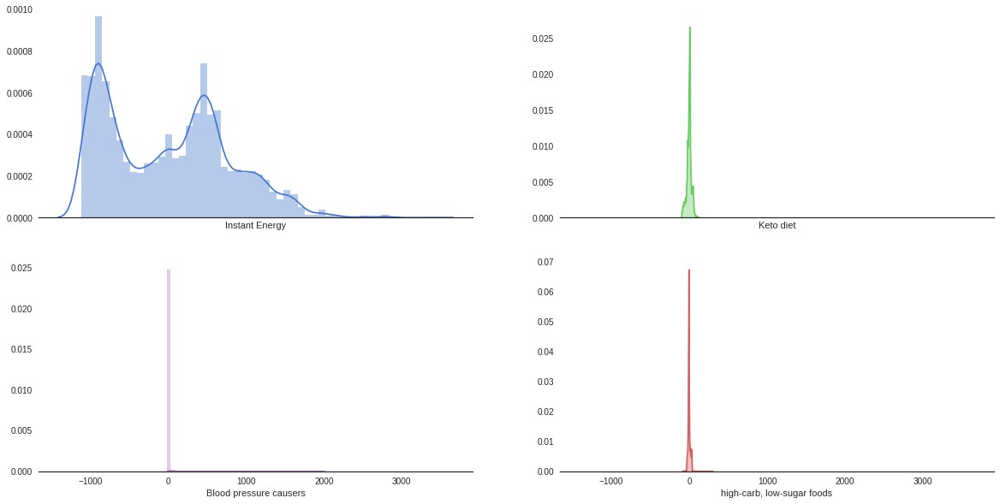

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import matplotlib.cbook
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)
sns.set(style="white", palette="muted", color_codes=True)


# Set up the matplotlib figure
f, axes = plt.subplots(2, 2, figsize=(20, 10), sharex=True)
sns.despine(left=True)
#['Instant Energy', 'Keto diet', 'high-carb, low-sugar foods','Blood pressure causers'
# Plot a simple histogram with binsize determined automatically
sns.distplot(midterm['Instant Energy'], color="b", ax=axes[0, 0])
sns.distplot(midterm['Keto diet'], color="g", ax=axes[0, 1])
sns.distplot(midterm['high-carb, low-sugar foods'], color="r", ax=axes[1, 1])
sns.distplot(midterm['Blood pressure causers'], color="m", ax=axes[1, 0])

### Word Cloud

In [0]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

#### Instant Energy foods

Find protein foods in the 98th percentile

In [0]:
instant_energy_df = midterm[midterm['Instant Energy'] > midterm['Instant Energy'].quantile(.98)]
instant_energy_text = midterm['product'].values
len(instant_energy_text)

45026

Word Cloud High Protein

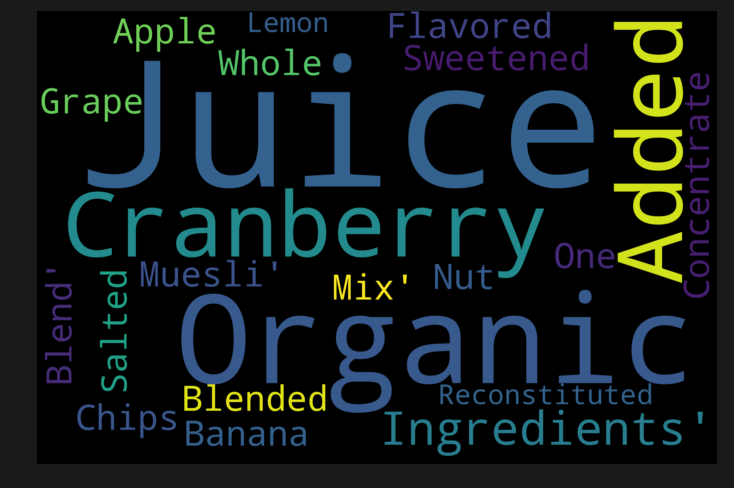

In [0]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(instant_energy_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

#### Keto foods

Find fatty foods in the 98th percentile

In [0]:
Keto_Diet_df = midterm[midterm['Keto diet'] > midterm['Keto diet'].quantile(.98)]
Keto_Diet_text = Keto_Diet_df['product'].values
len(Keto_Diet_text)

897

Word Cloud High Fat

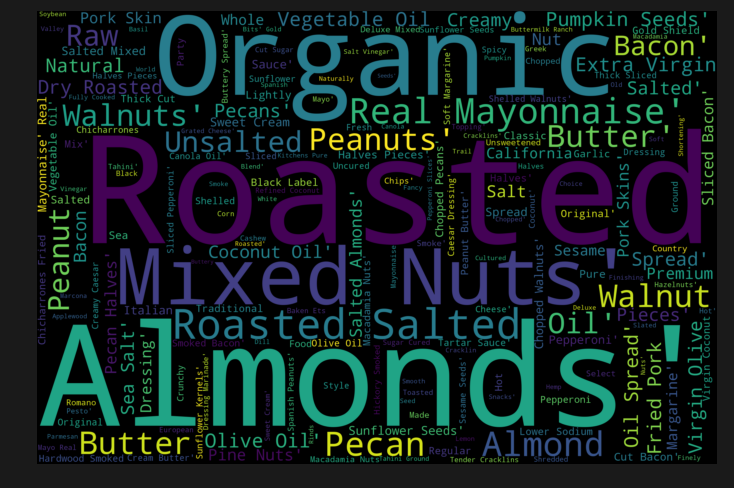

In [0]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(Keto_Diet_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

## Topic Modeling 

## Clustering

In [0]:
midterm.columns

Index(['product', 'Instant Energy', 'Keto diet', 'high-carb, low-sugar foods',
       'Blood pressure causers'],
      dtype='object')

### Create Features to Cluster

In [0]:
df_cluster_features = midterm.drop("product", axis=1)

In [0]:
df_cluster_features

,Instant Energy,Keto diet,"high-carb, low-sugar foods",Blood pressure causers
0,1157.002307,2.187805,10.979330,-3.067733
1,1723.999580,63.364721,-10.092472,0.825505
2,842.084358,-0.500709,10.449601,-2.790846
3,1225.507404,34.597462,5.175813,-0.827959
4,865.501680,-5.372377,6.767135,-2.303430
5,1802.547028,65.283044,-11.612207,-0.206618
6,537.891307,-8.377548,29.298399,-5.659645
7,421.481747,-6.554441,-10.970127,0.551720
8,1208.866968,10.285504,-10.739791,0.627269
9,674.821732,-21.168177,8.633550,-2.457606


### Scale the data

In [0]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
print(scaler.fit(df_cluster_features))
print(scaler.transform(df_cluster_features))

MinMaxScaler(copy=True, feature_range=(0, 1))
[[5.07049306e-01 4.41147495e-01 2.41957976e-01 2.58667005e-03]
 [6.33758190e-01 7.28830718e-01 1.87188750e-01 4.51775299e-03]
 [4.36673479e-01 4.28504815e-01 2.40581120e-01 2.72400852e-03]
 ...
 [5.07184307e-02 4.23539082e-01 1.97739431e-01 3.79039634e-03]
 [6.18273197e-02 4.09269679e-01 1.95451933e-01 3.87323729e-03]
 [5.59263473e-06 4.88678189e-01 2.08167412e-01 3.39353153e-03]]


#### Cluster Diagnostics

**Three **clusters seem ideal

##### Yellowbrick Visualizer Elbow Method

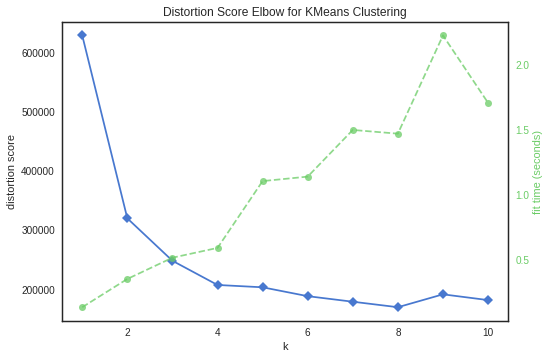

In [0]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer

# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,11))

visualizer.fit(df_cluster_features)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data

##### Yellowbrick Silhouette Visualizer


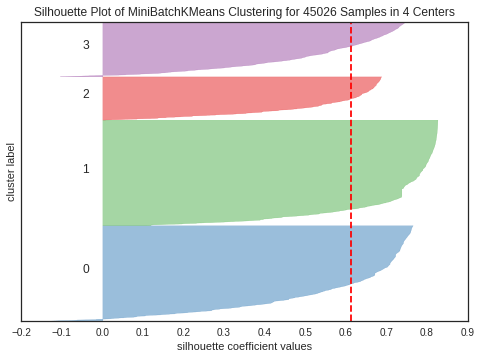

In [0]:
from sklearn.cluster import MiniBatchKMeans

from yellowbrick.cluster import SilhouetteVisualizer

# Instantiate the clustering model and visualizer
model = MiniBatchKMeans(4)
visualizer = SilhouetteVisualizer(model)

visualizer.fit(df_cluster_features) # Fit the training data to the visualizer
visualizer.poof() # Draw/show/poof the data

### Add Cluster Labels

In [0]:
from sklearn.cluster import KMeans

k_means = KMeans(n_clusters=3)
kmeans = k_means.fit(scaler.transform(df_cluster_features))
df['cluster'] = kmeans.labels_

df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product,cluster
0,28.57,64.29,14.29,3.57,0.00000,2267.85,Banana Chips Sweetened (Whole),2
2,57.14,17.86,3.57,17.86,1.22428,2835.70,Organic Salted Nut Mix,2
3,18.75,57.81,15.62,14.06,0.13970,1953.04,Organic Muesli,0
4,36.67,36.67,3.33,16.67,1.60782,2336.91,Zen Party Mix,2
5,18.18,60.00,21.82,14.55,0.02286,1976.37,Cinnamon Nut Granola,0


## 3D ClusterPlot

#### Strength-Weight Loss- Health 3D Plot

In [0]:
import plotly.offline as py
import plotly.graph_objs as go

from plotly.offline import init_notebook_mode
enable_plotly_in_cell()


trace1 = go.Scatter3d(
    x =midterm['Instant Energy'],
    y=midterm['Keto diet'],
    z=midterm['high-carb, low-sugar foods'],
    mode='markers',
    text=df["product"],
    marker=dict(
        size=12,
        color=df["cluster"],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)
#print(trace1)
data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="Strength-Weight Loss- Health",
    scene = dict(
        xaxis = dict(title='X: Instant Energy'),
        yaxis = dict(title="Y:  Keto diet"),
        zaxis = dict(title="Z:  high-carb, low-sugar foods"),
    ),
    width=1000,
    height=900,
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')



###Conclusion: 
* PCA was required  as there was correlation amongst the attributes
* Clear clusters were formed after that that could be easily categorised into diet plans 
* Further steps would be to consider the amount of food consumed and not just calculations per 100g to see how food clusters because we might eat one small  chocolate but a huge bowl of salads and that’s why volume has to be considered. 
